# Geospatial Validation

@roman 

22 June, 2023

Code to remove inconsistent data from geospatial data.


---
# Settings

In [41]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import uuid
import os

from INEGIpy import MarcoGeoestadistico
from scipy.spatial.distance import pdist, squareform


In [2]:
# Settings
# show 100 columns in pandas
pd.set_option('display.max_columns', 100)
geo_framework = MarcoGeoestadistico()

---
# Data

## Properties

In [3]:
# read parquet
gdf_properties = pd.read_parquet("../../data/interim/cleaned_data_s1.parquet")

# original columns
original_columns = gdf_properties.columns

# to geodataframe
gdf_properties = gpd.GeoDataFrame(
    gdf_properties,
    geometry=gpd.points_from_xy(gdf_properties['longitud'], gdf_properties['latitud']),
    crs='EPSG:4326'
    )

gdf_properties.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 956699 entries, 0 to 956698
Data columns (total 41 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   valor_fisico_construccion      956699 non-null  float64       
 1   id_avaluo                      956699 non-null  object        
 2   fecha_avaluo                   956699 non-null  datetime64[ns]
 3   colonia                        956699 non-null  object        
 4   id_clase_inmueble              956699 non-null  int64         
 5   id_tipo_inmueble               956699 non-null  int64         
 6   conservacion                   956699 non-null  float64       
 7   elevador                       924417 non-null  float64       
 8   niveles                        956699 non-null  int64         
 9   cve_ref_proximidad_urbana      956699 non-null  int64         
 10  cve_nivel_equipamiento_urbano  956699 non-null  int64       

In [4]:
# sample (for prototyping)
# gdf_properties = gdf_properties.sample(10000)

In [5]:
# see original cols
original_columns

Index(['valor_fisico_construccion', 'id_avaluo', 'fecha_avaluo', 'colonia',
       'id_clase_inmueble', 'id_tipo_inmueble', 'conservacion', 'elevador',
       'niveles', 'cve_ref_proximidad_urbana', 'cve_nivel_equipamiento_urbano',
       'valor_mercado', 'valor_concluido_total', 'nivel', 'unidades_rentables',
       'edad_anios', 'precio_m2', 'vida_util_remanente',
       'cve_clasificacion_zona', 'cve_vigilancia', 'regimen_propiedad',
       'tipo_vialidad', 'id_uv', 'id_municipio', 'id_entidad_f',
       'clave_controlador', 'clave_valuador', 'id_otorgante', 'cp', 'latitud',
       'longitud', 'recamaras', 'banos', 'medio_banos', 'estacionamiento',
       'superficie_terreno', 'superficie_construida', 'superficie_accesoria',
       'superficie_vendible', 'valor_fisico_terreno_m2'],
      dtype='object')

## States

In [6]:
# get all mexico states
gdf_mex_states = geo_framework.Entidades()
gdf_mex_states.head()

,geometry,cvegeo,cve_agee,nom_agee,nom_abrev,pob,pob_fem,pob_mas,viv
0,"MULTIPOLYGON (((-102.29739 22.45527, -102.2955...",01,01,Aguascalientes,Ags.,1425607,728924,696683,386671
1,"MULTIPOLYGON (((-114.11561 28.09639, -114.1152...",02,02,Baja California,BC,3769020,1868431,1900589,1149563
2,"MULTIPOLYGON (((-109.89451 22.87476, -109.8946...",03,03,Baja California Sur,BCS,798447,392568,405879,240660
3,"MULTIPOLYGON (((-91.95650 20.19700, -91.95636 ...",04,04,Campeche,Camp.,928363,471424,456939,260824
4,"MULTIPOLYGON (((-102.31549 29.88000, -102.3150...",05,05,Coahuila de Zaragoza,Coah.,3146771,1583102,1563669,901249


<Axes: >

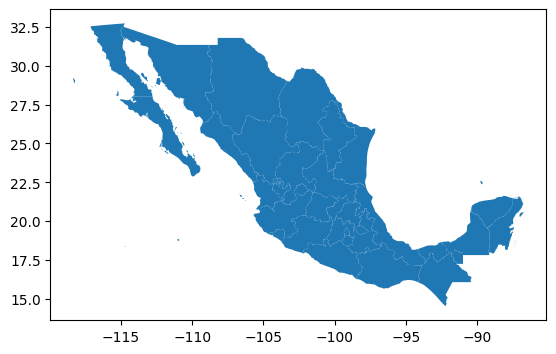

In [7]:
# plot states
gdf_mex_states.plot()

---
# Geospatial Validation

## S1: Points Inside Mexico

### Modify Data

In [8]:
# geodataframe
gdf_properties = (
    gdf_properties
    .assign(
        # in order to be aligned with the INEGI geo framework
        id_entidad_f=lambda x: x['id_entidad_f'].astype(str).str.zfill(2),
        id_municipio=lambda x: x['id_municipio'].astype(str).str.zfill(3)
    )
)

gdf_properties.loc[:, ['id_entidad_f', 'id_municipio']].head()

,id_entidad_f,id_municipio
0,07,027
1,07,107
2,03,008
3,09,003
4,21,051


### Spatial Join

In [9]:
# join properties with states, if the point is inside any state
gdf_properties_country_not_match = (
    gpd.sjoin(gdf_properties, gdf_mex_states, predicate='within', how='left')
    # get only the properties that did not match
    .loc[lambda x: x['cvegeo'].isna()]
    )

# print
print(f"Properties that did not match: {gdf_properties_country_not_match.shape[0]}")
print(f"Percentage of properties that did not match: {gdf_properties_country_not_match.shape[0] / gdf_properties.shape[0]}")

Properties that did not match: 24
Percentage of properties that did not match: 2.508626015078933e-05


<Axes: >

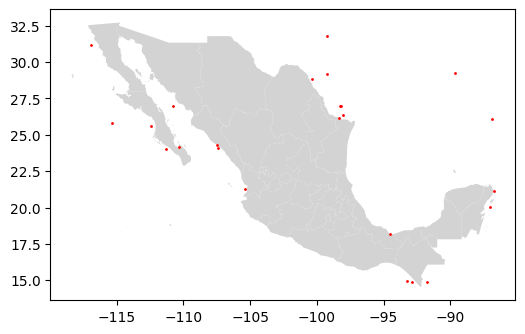

In [10]:
# plot properties that did not match
fig, ax = plt.subplots(figsize=(6, 6))
gdf_mex_states.plot(ax=ax, color='lightgrey')
gdf_properties_country_not_match.plot(ax=ax, color='red', markersize=1)

In [11]:
# clean the properties that did not match
gdf_properties = (
    gdf_properties
    .sjoin(gdf_mex_states, predicate='within', how='inner')
    .drop(columns=['index_right'])
    .loc[:, gdf_properties.columns]
)

In [12]:
# shape
gdf_properties.shape

(956675, 41)

## S2: Points inside each state 

In [13]:
# join properties with states, if the point is inside any state
gdf_properties_states_not_match = (
    gpd.sjoin(gdf_properties, gdf_mex_states, predicate='within', how='inner')
    .assign(id_entidad_f=lambda x: x['id_entidad_f'].astype(str).str.zfill(2))
    .query("id_entidad_f != cvegeo")
    )

print(f"Properties that did not match: {gdf_properties_states_not_match.shape[0]}")
print(f"Percentage of properties that did not match: {gdf_properties_states_not_match.shape[0] / gdf_properties.shape[0]}")

Properties that did not match: 187
Percentage of properties that did not match: 0.00019546868058640605


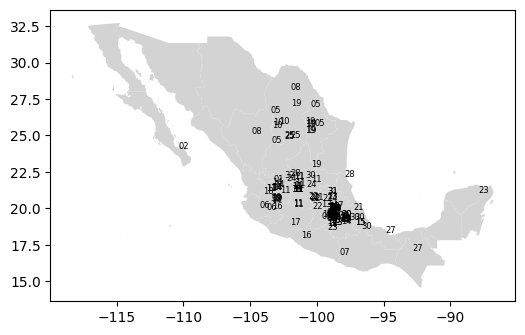

In [14]:
# plot properties that did not match
fig, ax = plt.subplots(figsize=(6, 6))
gdf_mex_states.plot(ax=ax, color='lightgrey')

# plot
for idx, row in gdf_properties_states_not_match.iterrows():
    ax.text(row.geometry.x, row.geometry.y, row['id_entidad_f'], fontsize=6)

In [15]:
# clean the properties that did not match
gdf_properties = (
    gpd.sjoin(gdf_properties, gdf_mex_states, predicate='within', how='inner')
    .query("id_entidad_f == cvegeo")
    .drop(columns=['index_right'])
    .loc[:, gdf_properties.columns]
)
# print
gdf_properties.shape

(956488, 41)

## S3: Points inside each municipality

In [16]:
def process_id_entidad(id_entidad, gdf_properties):
    """
    Process the GeoDataFrame for a given id_entidad and save the result.

    Parameters:
    - id_entidad (str): The id_entidad to process.
    - gdf_properties (GeoDataFrame): The GeoDataFrame of properties.
    """
    # Get municipalities of the state
    gdf_mun = geo_framework.Municipios(id_entidad)

    # Filter and join GeoDataFrames
    gdf_result = (
        gdf_properties
        .query("id_entidad_f == @id_entidad")
        .sjoin(gdf_mun, how='left', predicate='within')
        .query("id_municipio != cve_agem")
    )

    return gdf_result

# process
entity_list = gdf_properties['id_entidad_f'].unique()
wrong_mun_gdf = []

for entity in tqdm(entity_list):
    wrong_mun_gdf.append(process_id_entidad(entity, gdf_properties))


100%|██████████| 32/32 [00:40<00:00,  1.26s/it]


In [17]:
# concat
gdf_properties_wrong_mun = pd.concat(wrong_mun_gdf)

# print
print(f"Properties that did not match: {gdf_properties_wrong_mun.shape[0]}")
print(f"Percentage of properties that did not match: {gdf_properties_wrong_mun.shape[0] / gdf_properties.shape[0]}")

Properties that did not match: 11305
Percentage of properties that did not match: 0.011819280534622494


<Axes: >

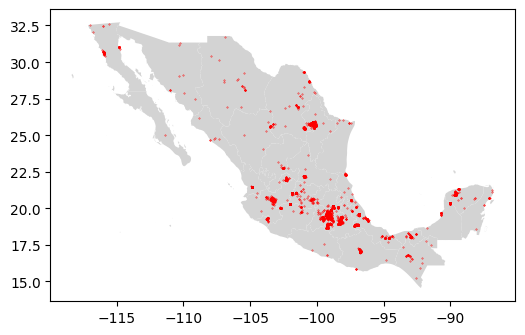

In [18]:
# plot
fig, ax = plt.subplots(figsize=(6, 6))
gdf_mex_states.plot(ax=ax, color='lightgrey')
gdf_properties_wrong_mun.plot(ax=ax, color='red', markersize=0.1)

In [19]:
# clean the properties that did not match
index_unwanted = gdf_properties_wrong_mun.index

# drop
gdf_properties = gdf_properties.drop(index_unwanted, axis=0)

# print
gdf_properties.shape

(945183, 41)

---
# Duplicates

## S1: EDA

In [20]:
# unique id's
gdf_properties['id_avaluo'].nunique()

835432

In [21]:
# get properties with repeated id_avaluo
gdf_repeated_id_avaluo = (
    gdf_properties
    .assign(
        num_id_avaluo=lambda x: x.groupby('id_avaluo')['id_avaluo'].transform('count')
    )
    .query("num_id_avaluo > 1")
    .sort_values(['id_avaluo', 'fecha_avaluo'])
)
gdf_repeated_id_avaluo.shape

(166020, 42)

In [22]:
# see how many propertie
gdf_repeated_id_avaluo['id_avaluo'].nunique()

56269

In [23]:
# how many properties are repeated in avg
gdf_repeated_id_avaluo['id_avaluo'].value_counts().mean()

2.9504700634452363

## S2: Spot different properties in same ID

In [24]:
# generate function that compares
def get_geometric_distance(x):
    # copy
    x = x.copy()

    # get format of coords
    coords = np.array(list(
        x.geometry.apply(lambda z: (z.x, z.y))
    ))
    # distance matrix
    d_matrix = squareform(pdist(coords, metric='euclidean'))

    # get upper triangle
    upper_triangle = np.triu_indices(d_matrix.shape[0], k=1)

    # get distances
    distances = d_matrix[upper_triangle].mean()

    return distances


def get_distance(x):
    # copy
    x = x.copy()

    # get format
    a_x = x.values.reshape(-1, 1)

    # distance
    d_matrix = squareform(pdist(a_x, metric='euclidean'))

    # get upper triangle
    upper_triangle = np.triu_indices(d_matrix.shape[0], k=1)

    # get distances
    distances = d_matrix[upper_triangle].mean()

    return distances


def compare_duplicate(gdf):
    """
    Function that compares the duplicates of a DataFrame with the same id_avaluo.
    It will compare the distance between some columns of the duplicates like the geometry,
    the time and characteristics.
    ---
    Parameters:
    - gdf (Dataframe): The Dataframe of the duplicates.

    Returns:
    - Series: The Series with the comparison.
    """
    # copy
    gdf = gdf.copy()

    # compare distance
    distance = get_geometric_distance(gdf['geometry'])

    # compare time
    time_diff = get_distance(gdf['epoch'])

    # compare characteristics
    superficie_vendidible_diff = get_distance(gdf['superficie_vendible'])

    # compare price
    valor_concluido_diff = get_distance(gdf['valor_concluido_total'])


    return pd.Series({
        'distance': distance,
        'time_diff': time_diff,
        'superficie_vendible_diff': superficie_vendidible_diff,
        'valor_concluido_diff': valor_concluido_diff,
        'num_duplicates': gdf.shape[0]
    })

In [25]:
# compare
df_repeated_stats = (
    gdf_repeated_id_avaluo
    .assign(
        epoch = lambda x: (
            x['fecha_avaluo'] - pd.Timestamp("1970-01-01")
            ).dt.days
    )
    .to_crs('EPSG:6372')
    .groupby('id_avaluo', as_index=False)
    .apply(compare_duplicate, include_groups=False)
)

/Users/ravj/opt/anaconda3/envs/mds-research-stay/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
/Users/ravj/opt/anaconda3/envs/mds-research-stay/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
/Users/ravj/opt/anaconda3/envs/mds-research-stay/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_d

In [26]:
# see
df_repeated_stats

,id_avaluo,distance,time_diff,superficie_vendible_diff,valor_concluido_diff,num_duplicates
0,11001221110013400,8372.768758,17.0,66.0,148000.0,2.0
1,11003190710070900,0.000000,0.0,14.0,125000.0,2.0
2,11003190910062700,4328.035918,1.0,29.0,1067000.0,2.0
3,11003190910063300,0.000000,0.0,3.0,137000.0,2.0
4,11003190910064200,0.000000,0.0,34.0,1911000.0,2.0
...,...,...,...,...,...,...
56264,9083191110456280,0.000000,0.0,0.0,0.0,4.0
56265,9086212810326830,0.000000,0.0,0.0,0.0,8.0
56266,9086212810326840,0.000000,0.0,0.0,0.0,8.0
56267,9086212810326850,0.000000,0.0,0.0,0.0,8.0


In [27]:
# get total distance
vars_x = ['distance', 'time_diff', 'superficie_vendible_diff', 'valor_concluido_diff']

df_repeated_stats['total_distance'] = (
    df_repeated_stats['distance']
    + df_repeated_stats['time_diff']
    + df_repeated_stats['superficie_vendible_diff']
    + df_repeated_stats['valor_concluido_diff'].div(1e+4)
    )

# see how many properties have 0 distance
mask = df_repeated_stats['total_distance'].le(10)

# same id_avaluo
print("same id avaluo")
print(mask.sum())
print(mask.mean())

# sum properties
print("\ntotal properties")
print(df_repeated_stats.loc[mask ,'num_duplicates'].sum())
print(df_repeated_stats.loc[mask ,'num_duplicates'].sum() / gdf_properties.shape[0])

same id avaluo
3376
0.059997511951518596

total properties
9121.0
0.009649983124960987


In [28]:
# distribution of distances
df_repeated_stats[vars_x].describe()

,distance,time_diff,superficie_vendible_diff,valor_concluido_diff
count,56269.000000,56269.000000,56269.000000,5.626900e+04
mean,35858.360056,0.969258,30.648765,5.413977e+05
std,68585.093599,4.421657,52.843370,1.690331e+06
min,0.000000,0.000000,0.000000,0.000000e+00
25%,74.412417,0.000000,1.200000,2.586667e+04
50%,9950.008310,0.000000,13.133333,1.533333e+05
75%,28860.627085,0.500000,39.000000,4.750000e+05
max,724491.882669,166.833333,1209.000000,7.932900e+07


<Axes: xlabel='distance', ylabel='Count'>

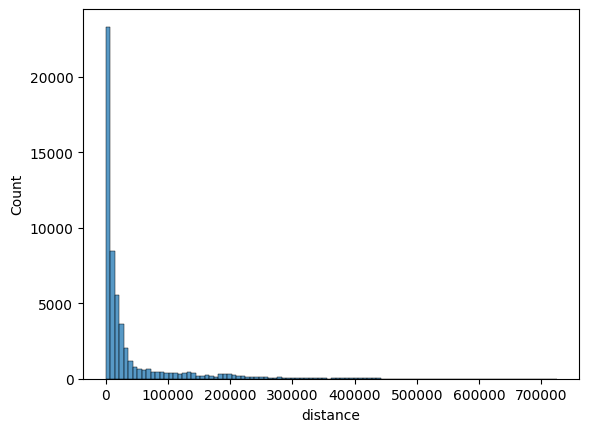

In [29]:
# see distribution of distance
sns.histplot(df_repeated_stats.query("distance > 0")['distance'], bins=100)

In [30]:
# see deciles of distance
df_repeated_stats['distance'].quantile(np.linspace(0, 1, 11))

0.0         0.000000
0.1        13.698096
0.2        35.505698
0.3       940.288445
0.4      5695.714007
0.5      9950.008310
0.6     15212.911364
0.7     22983.208220
0.8     40712.752741
0.9    118693.531429
1.0    724491.882669
Name: distance, dtype: float64

## S3: Flag duplicates

In [31]:
# flag duplicates
df_repeated_stats = (
    df_repeated_stats
    .assign(
        flag_duplicate_total_dist=lambda x: (
            x['total_distance'].gt(10)
        ).astype(int),
        flag_time=lambda x: (
            (
            x['distance'].le(10)
            & x['valor_concluido_diff'].div(1e+4).le(2.5)
            & x['superficie_vendible_diff'].le(10)
            )
            & x['time_diff'].gt(0)
        ).astype(int),
        flag_heuristic=lambda x: (
            ~(
                x['valor_concluido_diff'].div(1e+4).le(2.5)
                & x['superficie_vendible_diff'].le(10)
                & x['time_diff'].le(0)
            )
        ).astype(int),
        has_flag=lambda x: (
            x['flag_time']
            | x['flag_heuristic']
            | x['flag_duplicate_total_dist']
            )
    )
)
df_repeated_stats

,id_avaluo,distance,time_diff,superficie_vendible_diff,valor_concluido_diff,num_duplicates,total_distance,flag_duplicate_total_dist,flag_time,flag_heuristic,has_flag
0,11001221110013400,8372.768758,17.0,66.0,148000.0,2.0,8470.568758,1,0,1,1
1,11003190710070900,0.000000,0.0,14.0,125000.0,2.0,26.500000,1,0,1,1
2,11003190910062700,4328.035918,1.0,29.0,1067000.0,2.0,4464.735918,1,0,1,1
3,11003190910063300,0.000000,0.0,3.0,137000.0,2.0,16.700000,1,0,1,1
4,11003190910064200,0.000000,0.0,34.0,1911000.0,2.0,225.100000,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...
56264,9083191110456280,0.000000,0.0,0.0,0.0,4.0,0.000000,0,0,0,0
56265,9086212810326830,0.000000,0.0,0.0,0.0,8.0,0.000000,0,0,0,0
56266,9086212810326840,0.000000,0.0,0.0,0.0,8.0,0.000000,0,0,0,0
56267,9086212810326850,0.000000,0.0,0.0,0.0,8.0,0.000000,0,0,0,0


In [32]:
# see some flag_time
(
    df_repeated_stats
    .query("flag_time.eq(1)")
    )

,id_avaluo,distance,time_diff,superficie_vendible_diff,valor_concluido_diff,num_duplicates,total_distance,flag_duplicate_total_dist,flag_time,flag_heuristic,has_flag
1154,11004222810264900,6.149637,1.000000,0.0,0.000000,2.0,7.149637,0,1,1,1
2612,11007222410212700,1.862171,42.000000,0.0,0.000000,2.0,43.862171,1,1,1,1
2865,11008191110005100,7.384599,0.666667,0.0,0.000000,3.0,8.051266,0,1,1,1
3560,14003191410168100,0.000000,0.666667,0.0,14666.666667,3.0,2.133333,0,1,1,1
4106,14003201410227500,0.000000,0.666667,0.0,18000.000000,3.0,2.466667,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...
54013,30013203010084500,0.000000,1.000000,0.0,0.000000,2.0,1.000000,0,1,1,1
54217,30013211710115500,0.000000,0.500000,0.0,0.000000,4.0,0.500000,0,1,1,1
54305,30013211710142600,4.469493,19.000000,0.0,0.000000,2.0,23.469493,1,1,1,1
55577,31002193110080600,8.319528,1.000000,0.0,0.000000,2.0,9.319528,0,1,1,1


In [33]:
# counts
df_repeated_stats['has_flag'].value_counts()

has_flag
1    53359
0     2910
Name: count, dtype: int64

In [34]:
# join with gdf_properties
gdf_properties2 = (
    gdf_properties
    .merge(
        df_repeated_stats,
        how='left',
        on='id_avaluo'
        )
    .assign(has_flag=lambda x: x['has_flag'].fillna(np.nan))
)
print(f"Total properties: {gdf_properties2.shape[0]}")


Total properties: 945183


## S4: Subset Unique & Not Unique Properties

## Partition

In [35]:
# subset by flags and not flags
gdf_unique_properties = gdf_properties2.query("has_flag.isna()").copy()
gdf_properties_not_flag = gdf_properties2.query("has_flag.eq(0)").copy()
gdf_properties_flag = gdf_properties2.query("has_flag.eq(1)").copy()
print(f"Flag properties: {gdf_properties_flag.shape[0]}")
print(f"Not flag properties: {gdf_properties_not_flag.shape[0]}")

Flag properties: 158317
Not flag properties: 7703


## Flagged

In [36]:
# flag time
gdf_properties_flag_time = (
    gdf_properties_flag
    .query("flag_time.eq(1)")
    .sort_values('fecha_avaluo', ascending=True)
    .groupby('id_avaluo')
    # the way to handle duplicates of time
    .last()
    .reset_index()
)
print(f"Flag time properties before: {gdf_properties_flag.query('flag_time.eq(1)').shape[0]}")
print(f"Flag time properties after: {gdf_properties_flag_time.shape[0]}")


Flag time properties before: 161
Flag time properties after: 67


In [37]:
# flag duplicate total dist or flag heuristic
gdf_properties_flag_not_time = (
    gdf_properties_flag
    .sort_values(['id_avaluo'])
    .query("flag_time.eq(0)")  # the complement
    .assign(
        # sub-id: concat longitud, latitud, fecha_avaluo, superficie_vendible, valor_concluido_total
        sub_id=lambda x: (
            x['longitud'].astype(str)
            + x['latitud'].astype(str)
            + x['fecha_avaluo'].astype(str)
            + x['superficie_vendible'].astype(str)
            + x['valor_concluido_total'].astype(str)
        ),
        # ngroup (get distinct values)
        n_group_sub_id=lambda x: x.groupby(['id_avaluo', 'sub_id']).cumcount(),
    )
    # get a random obs
    .groupby(['id_avaluo', 'sub_id'], as_index=False)
    # .sample(1, random_state=42)  # get rid of sistematique bias
    .last()  # change to "sample"
)
gdf_properties_flag_not_time
print(f"Flag not time properties before: {gdf_properties_flag.query('flag_time.eq(0)').shape[0]}")
print(f"Flag not time after: {gdf_properties_flag_not_time.shape[0]}")

Flag not time properties before: 158156
Flag not time after: 153453


## Not-Flagged

In [38]:
# get on property randomly
gdf_properties_not_flag = (
    gdf_properties_not_flag
    .groupby('id_avaluo', as_index=False)
    .sample(1, random_state=42)
)
print(f"Not flag properties after: {gdf_properties_not_flag.shape[0]}")

Not flag properties after: 2910


## Concatenate

In [39]:
# concat
gdf_properties3 = (
    pd.concat(
        [
            # good properties
            gdf_unique_properties,
            # properties repeated without differences
            gdf_properties_not_flag, 
            # properties repeated with differences
            gdf_properties_flag_time, gdf_properties_flag_not_time
        ],
        ignore_index=True
        )
    .assign(
        # new id
        property_id=lambda x: [uuid.uuid4().hex for _ in range(x.shape[0])]
    )    
)
print(f"Flag properties: {gdf_properties3.shape[0]}")
print(f"Perc flag properties: {gdf_properties3.shape[0] / gdf_properties.shape[0]}")

/Users/ravj/opt/anaconda3/envs/mds-research-stay/lib/python3.10/site-packages/geopandas/array.py:1486: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 (the single non-null crs provided).
  warnings.warn(


Flag properties: 935593
Perc flag properties: 0.9898538166683065


---
# Save

In [43]:
# subset
gdf_properties3 = gdf_properties3[['property_id'] + list(original_columns)]

# save
os.makedirs("../../data/interim", exist_ok=True)
gdf_properties3.to_parquet("../../data/interim/cleaned_data_s2.parquet")

---
# Sandbox

In [ ]:
# crs
gdf_properties_wrong_mun

In [ ]:
# see 9067220712861680 id_avaluo
gdf_properties_wrong_mun.loc[lambda x: x['id_avaluo'] == '9067220712861680']

In [ ]:
# see 9067220712861680 id_avaluo
gdf_properties.loc[lambda x: x['id_avaluo'] == '9067220712861680']

In [ ]:
index_unwanted

In [ ]:
df_repeated_stats['id_avaluo'].nunique()

In [ ]:
df_repeated_stats

In [ ]:
df_repeated_stats.query("has_flag.eq(1)")

In [ ]:
gdf_properties2['has_flag'].value_counts(dropna=False)

In [ ]:
gdf_properties2['flag_time'].value_counts(dropna=False)

In [ ]:
df_repeated_stats['flag_time'].value_counts(dropna=False)

In [ ]:
gdf_properties_flag.query('flag_time.eq(1)').shape[0]

In [ ]:
gdf_properties_flag_not_time['num_samples_repeated'].value_counts()

In [ ]:
gdf_properties_flag_not_time['id_avaluo'].value_counts()

In [ ]:
gdf_properties_flag_not_time['n_group_sub_id'].value_counts().sort_index()

In [ ]:
gdf_properties.query("id_avaluo == '11001221110013400'")

In [ ]:
gdf_properties_flag_not_time.query("id_avaluo == '11001221110013400'")

In [ ]:
original_columns